**Advait Kinikar**

**Director id: kinikara**

**UID: 120097997**

**PROBLEM 1:**

In the following code cell, we mount to Google drive so that its features can be used to

        A) To read our chessboard images
        B) To read our problem2 dataset

In [ ]:
# mounting to google drive
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In this code snippet, here we give the path to folder we will be accessing

In [ ]:
# accessing the folder
path_to_folder = "ENPM673/Project3"
%cd /content/drive/My\ Drive/{path_to_folder}

/content/drive/My Drive/ENPM673/Project3


Here, we import all the necessary libraries


      1) Opencv -for reading,writing images as well as performing image processing opertions.
      2) Numpy- to access the image array and process the image by array indexing.

In [ ]:
# importing necessary libraries
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import glob
from google.colab.patches import cv2_imshow

Now, some cameras introduce, significant distortion to images. These distortions are broadly of two kinds

          A) Radial Distortion
          b) Tangetial Distortion

In radial distortion, straight lines appear to be curved. Numerically, radial distortion is given as:

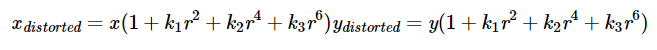

Source: https://docs.opencv.org/4.x/dc/dbb/tutorial_py_calibration.html

Following is an example of radial (barrel) distortion:

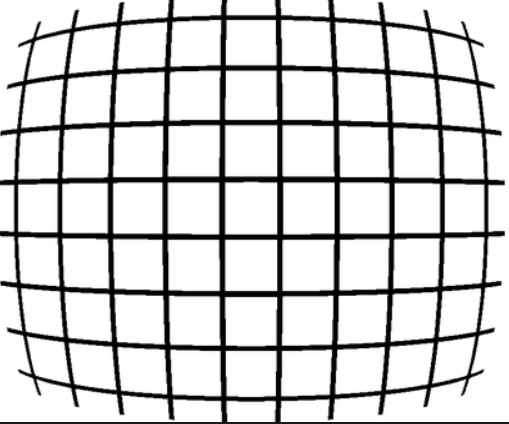

source: Bellavia, Fabio & Gagliano, G & Tegolo, Domenico & Valenti, C. (2006). Underwater archaeological mosaicing.

In tangential distortion, some areas look nearer than expected. Numerically, tangential distortion is as follows:

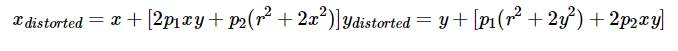

source: https://docs.opencv.org/4.x/dc/dbb/tutorial_py_calibration.html

Following is an example of tangential distortion:

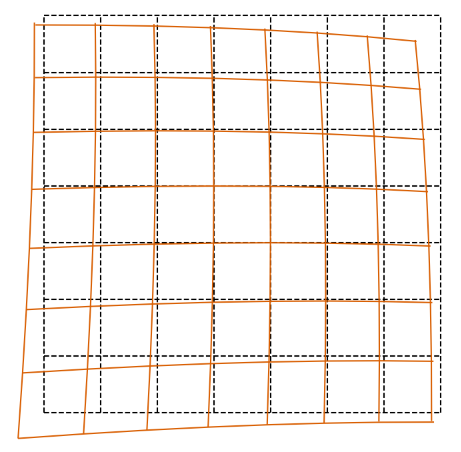

source: https://www.tangramvision.com/blog/camera-modeling-exploring-distortion-and-distortion-models-part-i

In both these distortion equations, it can be observed, that there are some coefficients or parameters, which if known can help us fix the distortion. These coefficients are known as distortion coefficients.

      Distortion Coefficients = (k1,k2,p1,p2,k3)

Here, k1,k2,k3 represent radial distortion and p1,p2 represent tangential distortion. Along with these 'distortion coefficents' we also need some intrinsic and extrinsic parameters, which would help us calibrate the camera and prevent any distorted images. The intrinsic parameters are the focal length, optical centers(principle points) of the camera. These are used to create a camera matrix. The camera matrix is given by [fx 0 cx;0 fy cy; 0 0 1] where (fx,fy) is the focal length of the camera and (cx,cy) are the principle points.
The extrinsic parameters are the rotation and translation vectors, which transform the coordinates of 3D point onto a 2D system

For calibrating the camera, we will utilize a set of 50 images of a chessboard. Here is the link to the folder containing the images: https://drive.google.com/drive/folders/1kcX5nMredChpxtV3e64thOE3dfkKqYcL?usp=sharing

Following is a rough outline of the 'pipeline' or steps that we will take for calibrating a camera

         1) Get images of a chessboard from different viewpoints
         2) Identify the correspondence between 3D points (in real world) and 2D points (in image).
                a) Find the corners in the pattern
                b) Store the 3D and 2D coordinates of the corners in a list
         3) Use the collected 'corners' information to find distortion coefficients, intrinsic and extrinsic parameters
         4) Undistort the images using these parameters and process them if necessary.This is done by finding a new optimal camera matrix
         5) Calculate the reprojection error for each image. Reprojection error measures the discrepancy between the detected corners and the projected corners from the calibration parameters. Also find the new corner coordinates. Done to validate the accuracy of the calibration
         6) Plot the reprojection errors
         7) Display the image showing calibration results (A before and After image. This involves the the old and the new corners which we were found being plotted on the image)

  




In the code below,

A) The variable 'criteria', is basically a tuple, which stores the information on how to stop an algorithm from running.

cv.TERM_CRITERIA_EPS: This stops the algorithm (corner detection) based on epsilon value. It basically tells the algorithm that it is close enough to real corner positions.

cv.TERM_CRITERIA_MAX_ITER: This stops the algorithm aftr certain number of attempts

So in the code, the corner finding algorithm will stop after 30 attempts or it would stop, if the detected corners are within 0.001 units of the original position

B) object_points is an array or a matrix, which represents the 3D coordinates of the corners in a real world. Since the size of the chessboard (number of inner corners) is 8*5, a matrix of size 40x3 is created, where 40 is the number of coordinate points and 3 is (X,Y,Z).


In [ ]:
# Creating object points (which are 3D coordinates of the corners in real world)
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)
object_points = np.zeros((5 * 8, 3), np.float32)
object_points[:,:2] = np.mgrid[0:8,0:5].T.reshape(-1,2)

These are just 2 lists initialized to store the 3D points (world points) and 2D points (image points) of the corners

In [ ]:
# lists to store the 3d coordinates (in the world) and 2d coordinates (in the image)
world_points = []
image_points = []

All the 50 images from the folder are acquired

In [ ]:
#getting images
images = glob.glob('images_chessboard/*.jpeg')

Setting the new height and width parameter for images

In [ ]:
# Fixed height and size of the images
new_width = 500
new_height = 500

We, iterate through each image, resize it, convert it to grayscale, find corners using cv.findChessboardCorners(grayscale, (8, 5), None).

If corners are found, we append the objectpoints to world_points list, then we find the corners accurately again using corners2 = cv.cornerSubPix(grayscale, corners, (11, 11), (-1, -1), criteria) and append the corners to image_points list

The cv.findChessboardCorners() function is designed to locate the internal corners of a chessboard pattern within an image. It works by searching for a grid of corners that resemble a chessboard, based on the specified dimensions.

The cv.cornerSubPix() function is used to refine the corner positions detected by cv.findChessboardCorners() to subpixel accuracy. (11, 11) specifies the size of the window around each corner used for corner refinement. (-1, -1) specifies the default criteria for refinement, where the function refines the corners until a certain accuracy level is reached or until a maximum number of iterations is performed.

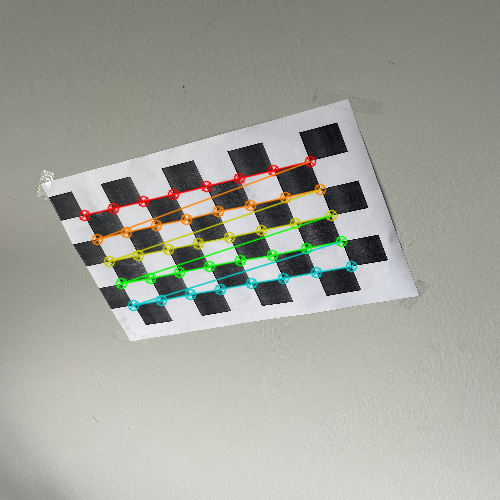

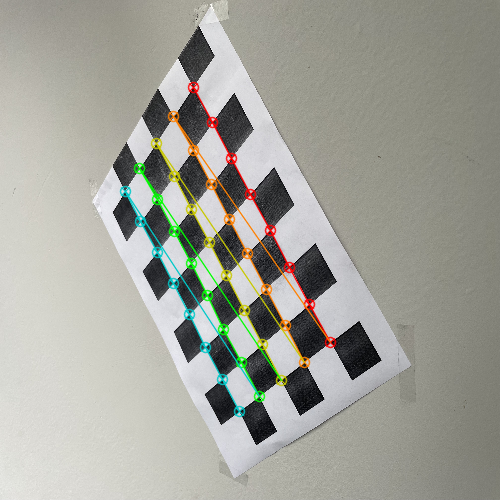

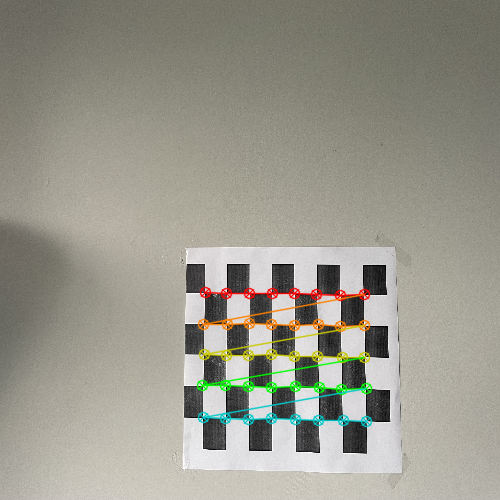

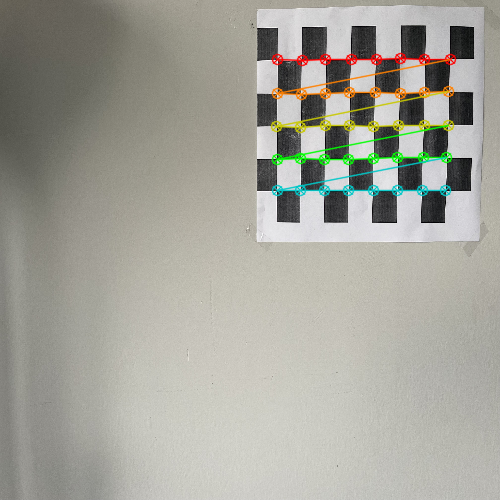

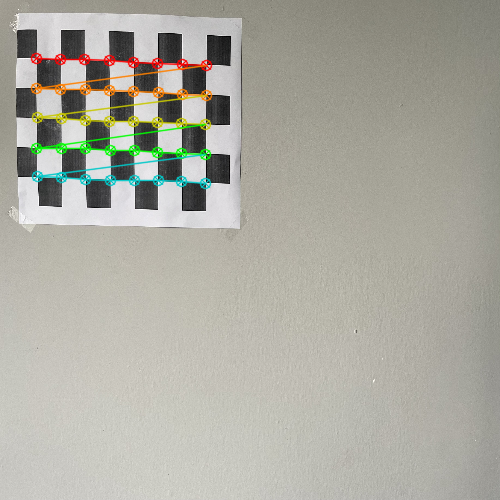

...

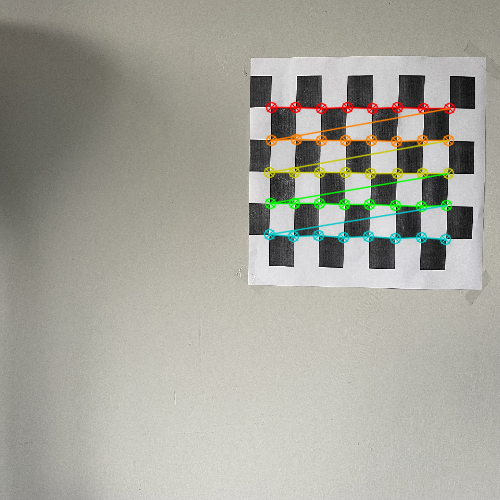

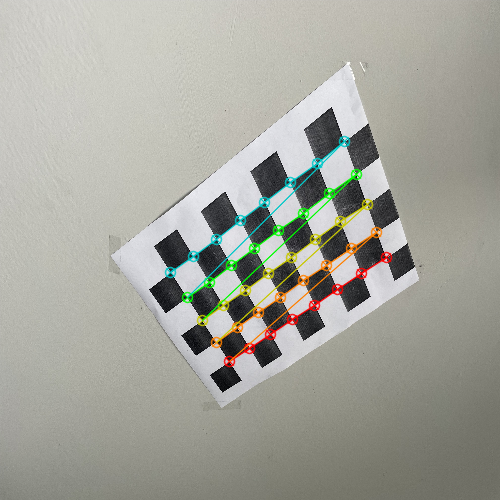

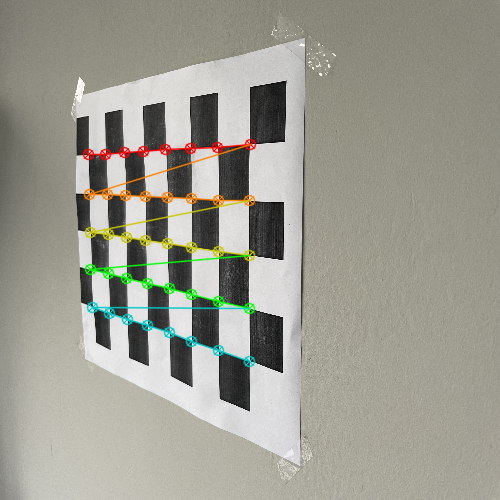

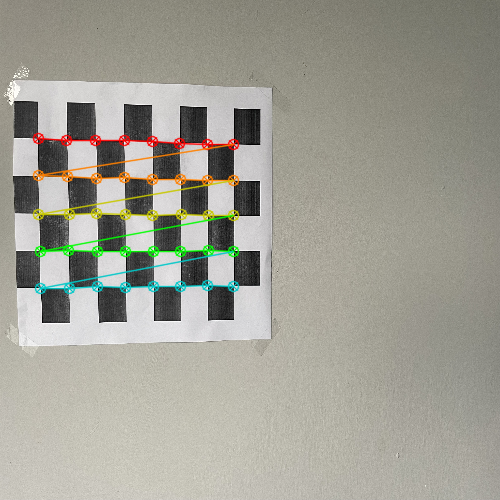

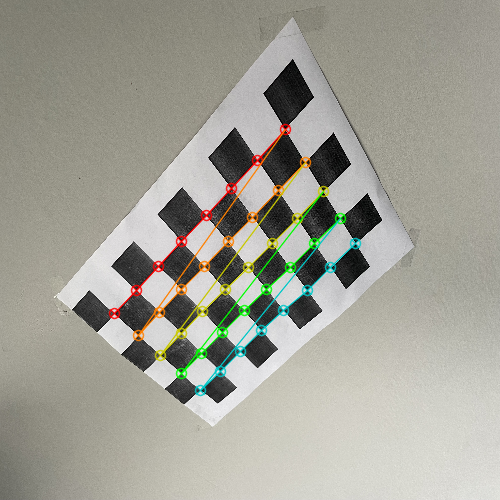

In [ ]:
# Resizing each image and finding the internal corners in the chessboard pattern
for image in images:
    i = cv.imread(image)
    new_image = cv.resize(i,(new_width,new_height))
    grayscale = cv.cvtColor(new_image,cv.COLOR_BGR2GRAY)
    ret, corners = cv.findChessboardCorners(grayscale, (8, 5), None)

# Appending lists with  the coordinates

    if ret == True:
        world_points.append(object_points)
        corners2 = cv.cornerSubPix(grayscale, corners, (11, 11), (-1, -1), criteria)
        image_points.append(corners2)
        cv.drawChessboardCorners(new_image,(8,5),corners,ret)
        cv2_imshow(new_image)
        cv.waitKey(1000)



Here, we use the cv.calibrateCamera, to perform 'camera calibration' and get the distance coefficients and the extrinsic parameters of the camera.

What the cv.calibrateCamera() does is basically, it takes in the 3D coordinates of points in the real world and their corresponding 2D coordinates in the images and then, it figures out how the camera distorts the image and calculates the parameters needed to undistort it. For this, it uses, optimization algorithms to minimize the difference between the actual 3D coordinates of points in the real world and their projected 2D coordinates in the images. It uses the The Levenberg-Marquardt algorithm for optimiztion, which minimizes the difference between observed and predicted values by adjusting the parameters (in this case, camera matrix, distortion coefficients, rotation, and translation vectors) in such a way that the error is minimized.

The adjusted parameters are what we get as outputs. These adjusted parameters, can be used to calibrate the camera

In [ ]:
# Performing camera calibration to get camera matrix, distortion factors, rotation and translation vectors
ret,cam_mat,dist_coeff,rotv,tranv = cv.calibrateCamera(world_points, image_points, (new_width,new_height), None, None)

Here, we use the found coefficients to get a new camera matrix. We use this new camera matrix, to undistort the image. It can be seen that the difference between the original image and the new undistorted image is very very subtle; this is because, the camera used for taking the images of the chessboard is already pretty well calibrated (camera from any latest smartphone)

Now, to find the new camera matrix, we use the cv.getOptimalNewCameraMatrix() function. It finds and returns a new camera matrix based on the scaling factor 'alpha'. The purpose of this function is to adjust the camera matrix, such that the distortion is minimized and the image is cropped to a 'Region of Interest' or 'ROI' which is basically the undistorted part of the image. The function first scales the image, based on the 'alpha' parameter. Now, alpha can be 0 or 1. When alpha is 0, the function gives a matrix such that, when the image is undistorted (by using cv.undistort), all the unwanted pixels at the corner and edges are removed. When alpha is 1, they are retained.

The new camera matrix, we get from the above function is applied using cv.undistort() function, to actually undistort the image. The function uses the original matrix and the new matrix to perform geometric transformations

In [ ]:
# Undistorting the images
for image in images:
    i = cv.imread(image)
    new_image = cv.resize(i,(new_width,new_height))
    height,width = new_image.shape[:2]
    new_matrix,region_of_interest = cv.getOptimalNewCameraMatrix(cam_mat,dist_coeff,(width,height),1,(width,height))

    undistorted = cv.undistort(new_image, cam_mat, dist_coeff,None,new_matrix)
    x, y, width, height = region_of_interest
    undistorted = undistorted[y:y+height, x:x+width]

    fig = plt.figure(figsize=(10, 7))
    rows = 1
    columns = 2

    fig.add_subplot(rows, columns, 1)
    plt.imshow(new_image)
    plt.axis('off')
    plt.title("Original")

    fig.add_subplot(rows, columns, 2)
    plt.imshow(undistorted)
    plt.axis('off')
    plt.title("undistorted")

Here, we calculate the reprojection errors for each image. It is basically tells how accurately the calibration is done. The reprojection error is calculated by comparing the projected 3D points(found by calibrated camera parameters) with actual 2D corner points detected on the original image. and measuring the difference between them.

A lower reprojection error indicates that the calibration parameters are accurate. The accuracy of the parameters determined increases as reprojection error comes close to zero. A high reprojection error on the other hand, tells that the parameters found are not very accurate.

In the pipeline, it is used to validate the calibration.

Now, reprojection error is calculated by transforming the 3D world points to 2D points by using cv.projectPose(). This gives the estimated location of the points on the image. Reprojection error, is simply the euclidean distance between the 2D projected points and actual points that we got from the original image. The reprojection error is expressed as norm of point correspondece errors as shown below:


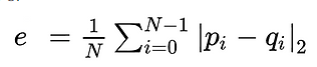

Here, pi is the original 2D point detected on the image, qi is the 2D projected point and N is number of points


In [ ]:
#calculating reprojection error
all_errors = []
image_number = []
image_points_reprojected = []

for i in range(len(world_points)):
    image_points2, _ = cv.projectPoints(world_points[i], rotv[i], tranv[i], cam_mat, dist_coeff)
    reprojection_error = cv.norm(image_points2, image_points[i], cv.NORM_L2)/len(image_points)
    all_errors.append(reprojection_error)
    image_points_reprojected.append(image_points2)

    image_number.append(int(i+1))

Here, we plot the reprojection errors for each image.

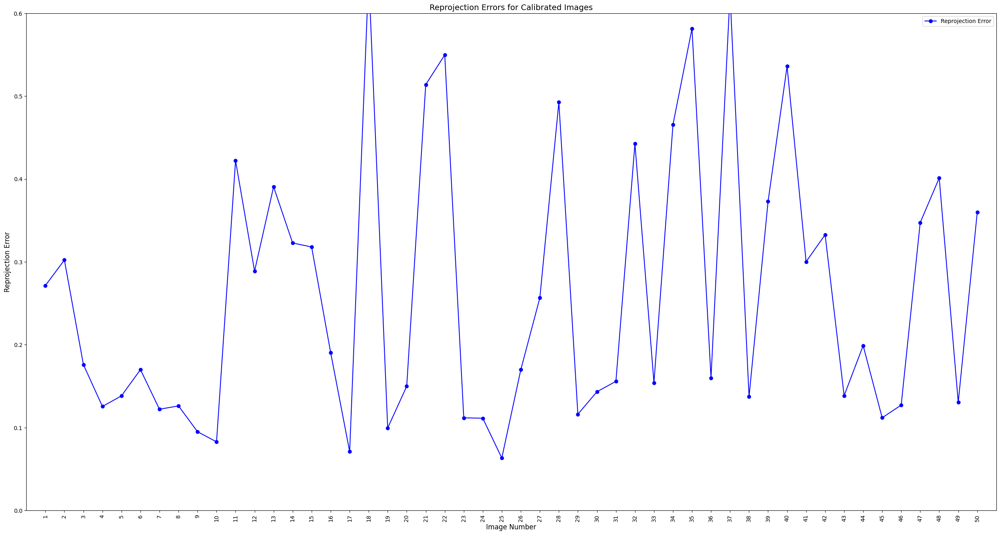

In [ ]:
# Plotting reprojection errors
plt.figure(figsize=(31, 16))
plt.plot(image_number, all_errors, marker='o', linestyle='-', color='blue', label='Reprojection Error')
plt.title('Reprojection Errors for Calibrated Images', fontsize=14)
plt.xlabel('Image Number', fontsize=12)
plt.ylabel('Reprojection Error', fontsize=12)
plt.xticks(range(1, 51), rotation=90)
plt.xlim([0, 51])
plt.ylim([0, 0.6])
plt.legend()
plt.show()


Here, we visualize the corners that were detected before image calibration i.e. before we got the parameters and after image calibration (when we reproject the points on the image). The yellow circles represent the corners detected originally. The red circles represent, the reprojected points

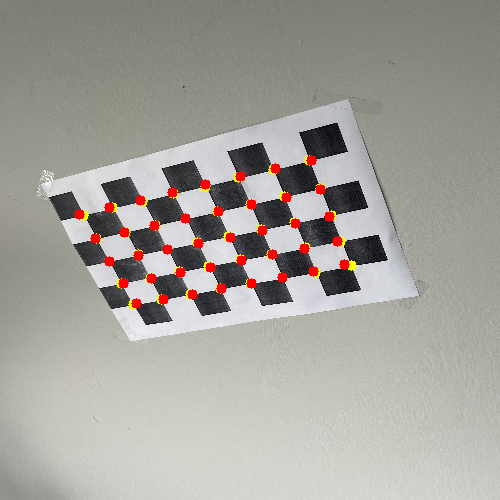

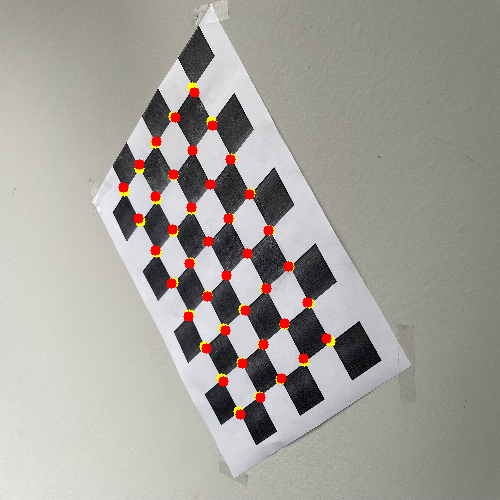

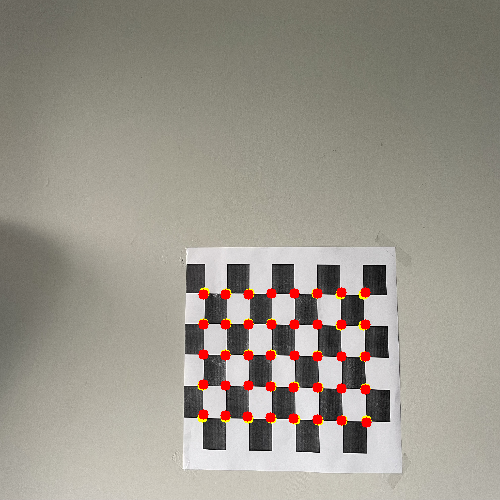

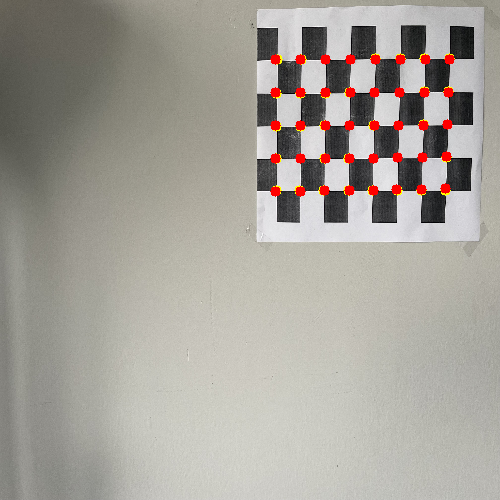

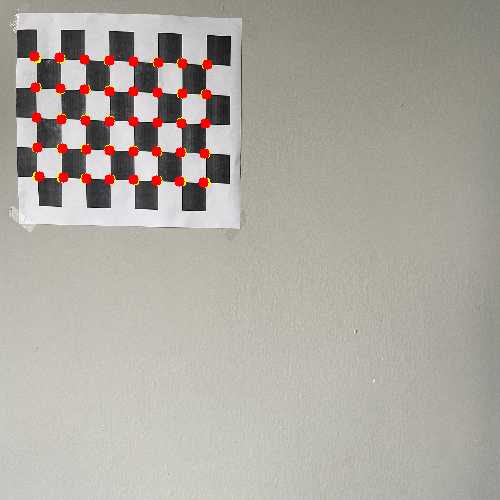

...

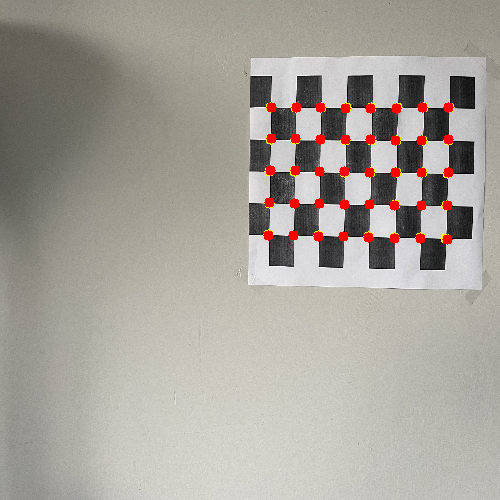

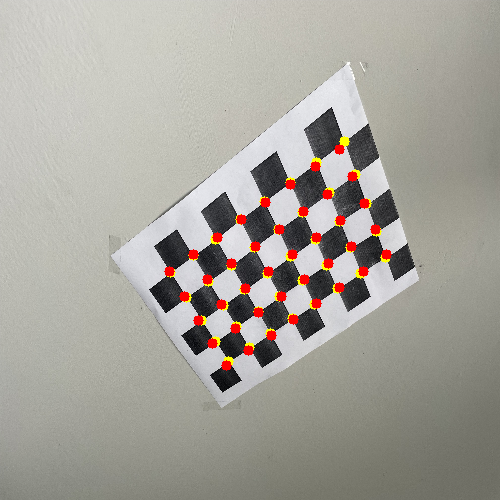

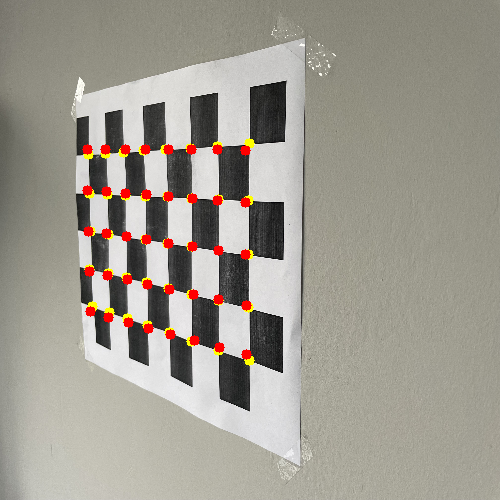

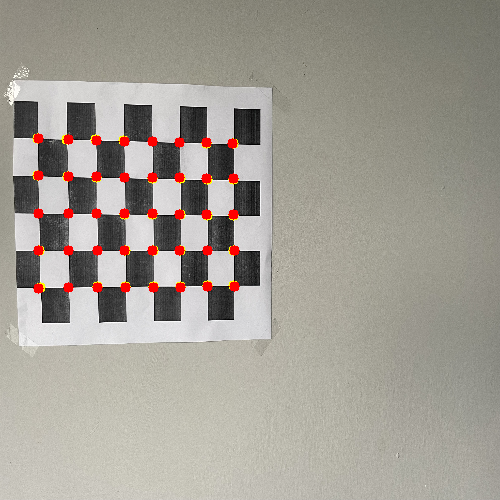

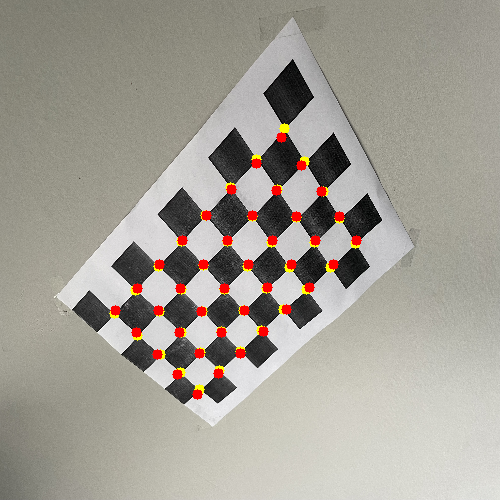

In [ ]:
#Images before and calibration
for image,corners,reprojected_points in zip(images,image_points, image_points_reprojected):
    i = cv.imread(image)
    resized = cv.resize(i,(new_width,new_height))

    for coordinates in corners:
        for i in coordinates.tolist():
            for values in range(len(i)-1):
                cv.circle(resized, (int(i[values]),int(i[values+1])), radius=5, color=(0, 255, 255), thickness=-1)

    for coordinates in reprojected_points:
        for i in coordinates.tolist():
            for values in range(len(i)-1):
                cv.circle(resized, (int(i[values]),int(i[values+1])), radius=5, color=(0, 0, 255), thickness=-1)

    cv2_imshow(resized)
    cv.waitKey(1000)


**PROBLEM 2**

Stereo vision simply involves reconstructing 3D geometry based on images from 2 or more viewpoints in a stereo vision system, where we have atleast 2 camera which are placed along the same X and Y axis.

Now, stereo vision is generally used to estimate depth or distance. There are multiple steps to achieve this. These steps are described in short below:
               
            A) Calibration of cameras:
               1) We first calibrate cameras i.e. get intrinsic and extrinsic parameters from the calibration
               2) Then, from the 2 images that we get (from 2 camera viewpoints), we identify features that match. We use these features to get a fundamental matrix
               3) This fundamental matrix is used to get aan essential matrix. This essential matrix the relative pose between 2 cameras.
               4) We decompose the essential matrix to get 2 rotational matrix and 1 translational vector
               5) These matrices and vectors are then used to rectify the stereo image and get homography matrices, which then in turn are used to rectify the image using perspective transformation.

            B) Creating epipolar scene using epipolar geometry:
              1) Epipolar geometry is important for finding correspondence points between two images taken from different viewpoints. When a 3D point is captured by two cameras, the projection of this point onto the image planes of both cameras forms a line known as an epipolar line. This line is unique to the 3D point and can be used to find the corresponding point in the other image.
              2) Now, finding corresponding points on images is important to create a disparity map
              3) The epipolar lines must run horizontally through the axis of the image. Most of the times, they donot hence, we rectify the images

            C) Build Disparity and Depth Map
            1) We use the rectified image, to get a disparity map. The disparity map represents the difference in x coordinates of corresponding points in the two images, which is used to estimate depth
            2) We then rescale the disparity map to a range suitable for visualization
            3) The, we get a depth map, using focal length and baseline of the image. The formula is:

            depth = (focal_length + baseline)/(disparity + doff)

            Here, doff = difference in principle points

The function below, is used to resize the image

In [ ]:
# Function to resize the image
def resize(image):
    image_height = image.shape[0]
    image_width = image.shape[1]

    aspect_ratio = image_width / image_height

    max_dimension = 600
    new_width = min(image_width, max_dimension)
    new_height = int(new_width / aspect_ratio)

    return cv.resize(image, (new_width, new_height))

The function below, matches the features between 2 images using SIFT feature extraction algorithm. The image is passed through the 'detectAndCompute' method of 'sift' object, to get the features i.e the keypoints and the descriptors of image. A comparison between SIFT and ORB was made and it was found that SIFT gives better matches.

In [ ]:
# Function to find features between images
def feature_matching(image1,image2):
    sift = cv.SIFT_create()

    keypoints_image1,descriptors_image1 = sift.detectAndCompute(image1,None)
    keypoints_image2, descriptors_image2 = sift.detectAndCompute(image2, None)

    bf = cv.BFMatcher(cv.NORM_L2, crossCheck= True)

    matches = bf.match(descriptors_image1,descriptors_image2)
    matches = sorted(matches, key=lambda x: x.distance)

    return matches,keypoints_image1,keypoints_image2

Here, we find the fundamental matrix. The fundamental matrix is a 3X3 matrix, that has the geometric relation between the two images. The matrix relates corresponding points in stereo images. It is useful for getting epipolar lines

In [ ]:
# Function to find the fundamental matrix
def find_fundamental_matrix(matches,keypoints_image1,keypoints_image2):
    coordinates_keypoints_1 = np.zeros((len(matches), 2), dtype=np.float32)
    coordinates_keypoints_2 = np.zeros((len(matches), 2), dtype=np.float32)

    i = 0
    for match in matches:
        coordinates_keypoints_1[i,:] = keypoints_image1[match.queryIdx].pt
        coordinates_keypoints_2[i, :] = keypoints_image2[match.trainIdx].pt
        i += 1

    fundamental_matrix,_ = cv.findFundamentalMat(coordinates_keypoints_1,coordinates_keypoints_2,cv.FM_RANSAC)

    return fundamental_matrix,coordinates_keypoints_1,coordinates_keypoints_2,matches

Here, we find the essential matrix. An essential matrix is similar to the fundamental matrix, but with 1 key difference. The essential matrix also incorporates the intrinsic paramters used for calibrated cameras

In [ ]:
# Function to find the essential matrix
def find_essential_matrix(fundamental_matrix,cam0_matrix,cam1_matrix):
    cam0_matrix_transpose = cam0_matrix.T
    A = np.dot(cam0_matrix_transpose,fundamental_matrix)
    essential_matrix = np.dot(A,cam1_matrix)

    return essential_matrix

Here, we decompose the essential matrix to get the rotation matrix 1, rotation matrix 2 and the translation vector

In [ ]:
# Function to find the rotation matrix and translation vectors
def decompose_essential_matrix(essential_matrix):
    rotation_matix_1, rotation_matrix_2, translation_vector = cv.decomposeEssentialMat(essential_matrix)
    return rotation_matix_1, rotation_matrix_2, translation_vector

We then rectify our images such that, the epipolar lines run horizontally, over them. Initially, I tried to use cv.stereoRectify() function, but the results were not accurate enough and the lines were not running horiontally. With cv.stereoRectifyUncalibrated(), the results are much better

In [ ]:
# Function to find homography matrices and rectify the image
def rectification_by_perspective_transformation(coordinates_keypoints_1,coordinates_keypoints_2,fundamental_matrix,image_width,image_height,image_1,image_2):
    _,H1, H2 = cv.stereoRectifyUncalibrated(coordinates_keypoints_1, coordinates_keypoints_2, fundamental_matrix, (image_width,image_height))
    rectified_img1 = cv.warpPerspective(image_1, H1, (image_width,image_height))
    rectified_img2 = cv.warpPerspective(image_2, H2, (image_width,image_height))

    return H1,H2,rectified_img1,rectified_img2

Here, we visualize the epipolar lines

In [ ]:
# Function to visualize the epipolar lines
def visualize_epipolar_lines_and_features(image1,image2,coordinates_keypoints_1,coordinates_keypoints2,fundamental_matrix):
    color_image1 = cv.cvtColor(image1, cv.COLOR_GRAY2RGB)
    color_image2 = cv.cvtColor(image2, cv.COLOR_GRAY2RGB)

    line1 = cv.computeCorrespondEpilines(coordinates_keypoints2.reshape(-1, 1, 2), 1, fundamental_matrix)
    line1 = line1.reshape(-1, 3)

    for i in range(len(coordinates_keypoints_1)):
        color = tuple(np.random.randint(0, 255, 3).tolist())

        # Draw epipolar lines corresponding to keypoints in the first image
        x0, y0 = map(int, [0, -line1[i][2] / line1[i][1]])
        x1, y1 = map(int, [color_image1.shape[1], -(line1[i][2] + line1[i][0] * color_image1.shape[1]) / line1[i][1]])
        cv.line(color_image1, (x1, y0), (x0, y1), color, 1)

    line2 = cv.computeCorrespondEpilines(coordinates_keypoints2.reshape(-1, 1, 2), 2, fundamental_matrix)
    line2 = line2.reshape(-1, 3)

    for i in range(len(coordinates_keypoints2)):
        color = tuple(np.random.randint(0, 255, 3).tolist())

        # Draw epipolar lines corresponding to keypoints in the first image
        x0, y0 = map(int, [0, -line2[i][2] / line2[i][1]])
        x1, y1 = map(int, [color_image2.shape[1], -(line2[i][2] + line2[i][0] * color_image2.shape[1]) / line2[i][1]])
        cv.line(color_image2, (x1, y0), (x0, y1), color, 1)


    return color_image1, color_image2

We calculate the deisparity using cv.StereoSGBM(). In general, the disparity is calulated as below:

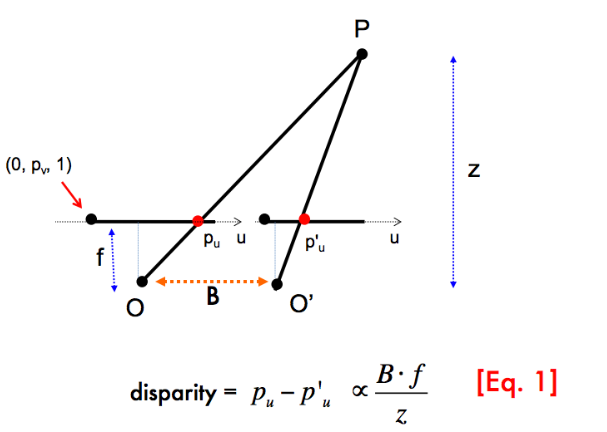/



In [ ]:
# Function to calculate the disparity map
def calculate_disparity(rectified_img1, rectified_img2):
    stereo = cv.StereoSGBM_create(minDisparity = 0, numDisparities=128, blockSize=19,disp12MaxDiff=2,uniquenessRatio=0,P1=0,P2=0,speckleWindowSize=200,speckleRange=2,mode = cv.STEREO_SGBM_MODE_SGBM)
    disparity = stereo.compute(rectified_img1, rectified_img2)
    return disparity.astype(np.float32)

We rescale the disparity map for visualization and convert it to grayscale and color (heatmap) map

In [ ]:
# Function to rescale the disparity map, convert to grayscale and heat map
def rescale_disparity(disparity):
    disparity_scaled = (disparity / 16.0)
    disp_norm = cv.normalize(disparity_scaled, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
    disparity_grayscale = (disp_norm*255).astype(np.uint8)
    disparity_color = cv.applyColorMap(disparity_grayscale, cv.COLORMAP_JET)
    return disparity_grayscale, disparity_color

We compute the depth from disparity. The formula is same as described above. Depth is inversely proportional to disparity. Now the camera can only be used, if the images are captured in a camera setup, wherein the cameras are truly parallel. If the camera is not parallel, there is a possibility of having negative and positive disparities. Inreality, most stereo images are obtained in a converged setup. For a converged setup, the above formula cannot be used. Hence, to get a depth map, we transform the disparity map into 3D points using a Q matrix. The Q matrix is obtained, when we use cv.stereoRectify() function, but since, I did not use the steeo rectify function for this project, I had to create a Q matrix of my own.

Now, in the Q matrix, The first row scales the x-coordinate by 1 and adjusts it by half of the image width multiplied by the focal length. The second row scales the y-coordinate by -1 (to flip the y-axis) and adjusts it by half of the image height multiplied by the focal length. The third row is used to scale the z-coordinate by the focal length and the baseline distance, which is crucial for depth estimation. The fourth row is used to scale the w-coordinate by the reciprocal of the baseline distance, which is necessary for the perspective division in the 3D to 2D transformation.

In [ ]:
def compute_depthImage(disparity, focal_length, baseline,image_width,image_height):
    # depth = (baseline*focal_length / disparity)

    disparity = cv.normalize(disparity, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
    Q = np.float32([
    [1, 0, 0, -0.5 * image_width * focal_length],
    [0, -1, 0, 0.5 * image_height * focal_length],
    [0, 0, 0, -focal_length * baseline],
    [0, 0, -1 / baseline, 0]])

    depth = cv.reprojectImageTo3D(disparity,Q)

    grayscale_depth = (depth * 255).astype(np.uint8)
    heatmap_depth = cv.applyColorMap(grayscale_depth, cv.COLORMAP_JET)
    return grayscale_depth,heatmap_depth

Below, is the pipeline described above, implemented in code

In [ ]:
def pipeline(cam0_matrix,cam1_matrix,ndisp,focal_length,baseline,i_vmin,i_vmax,image_1,image_2,image_width,image_height):
    gray_image1 = cv.cvtColor(image_1, cv.COLOR_RGB2GRAY)
    gray_image2 = cv.cvtColor(image_2, cv.COLOR_RGB2GRAY)

    matches,keypoints_image1,keypoints_image2 = feature_matching(gray_image1,gray_image2)
    fundamental_matrix,coordinates_keypoints_1,coordinates_keypoints_2,matches = find_fundamental_matrix(matches,keypoints_image1,keypoints_image2)
    print(f"The fundamental matrix is: {fundamental_matrix}")

    essential_matrix = find_essential_matrix(fundamental_matrix,cam0_matrix,cam1_matrix)
    print(f"The essential matrix is: {essential_matrix}")

    rotation_matrix1, rotation_matrix2, translation_vector = decompose_essential_matrix(essential_matrix)
    print(f"The rotation matrixces are : {rotation_matrix1} \n {rotation_matrix2} \n and the translation vector is: {translation_vector}")

    H1, H2, rectified_image1, rectified_image2 = rectification_by_perspective_transformation(coordinates_keypoints_1,
                                                                                             coordinates_keypoints_2,
                                                                                             fundamental_matrix,
                                                                                             image_width, image_height,
                                                                                             gray_image1, gray_image2)

    print(f"The Homography matrices are: {H1} and \n{H2}")

    visualisation_image1, visualisation_image2 = visualize_epipolar_lines_and_features(rectified_image1,rectified_image2,coordinates_keypoints_1,coordinates_keypoints_2,fundamental_matrix)
    resized_visualization_image1 = resize(visualisation_image1)
    resized_visualization_image2 = resize(visualisation_image2)

    disparity_map = calculate_disparity(rectified_image1,rectified_image2)
    disparity_grayscale,disparity_color = rescale_disparity(disparity_map)
    depth,heatmap_depth = compute_depthImage(disparity_map,focal_length,baseline,image_width,image_height)

    resized_disparity_color = resize(disparity_color)
    resized_disparity_grayscale = resize(disparity_grayscale)
    resized_depth_image = resize(depth)
    resized_heatmap_depth = resize(heatmap_depth)


    fig = plt.figure(figsize=(10, 7))
    rows = 3
    columns = 2

    fig.add_subplot(rows, columns, 1)
    plt.imshow(resized_visualization_image1)
    plt.axis('off')
    plt.title("Epipolar 1")

    fig.add_subplot(rows, columns, 2)
    plt.imshow(resized_visualization_image2)
    plt.axis('off')
    plt.title("Epipolar 2")

    fig.add_subplot(rows, columns, 3)
    plt.imshow(resized_disparity_grayscale,cmap='gray', vmin = 0, vmax = 255)
    plt.axis('off')
    plt.title("Disparity Map")

    fig.add_subplot(rows, columns, 4)
    plt.imshow(resized_disparity_color,cmap= 'jet',vmin = i_vmin, vmax= i_vmax)
    plt.axis('off')
    plt.title("Disparity map Color")

    fig.add_subplot(rows, columns, 5)
    plt.imshow(resized_depth_image,cmap='gray',vmin=0, vmax= 255)
    plt.axis('off')
    plt.title("Depth map")

    fig.add_subplot(rows, columns, 6)
    plt.imshow(resized_heatmap_depth,cmap='jet')
    plt.axis('off')
    plt.title("Depth map")




Below, is the dataset used for the project

In [ ]:

    # Dataset image 1 and its parameters
    classroom_img_0 = cv.imread('problem2_dataset/classroom/im0.png')
    classroom_img_1 = cv.imread('problem2_dataset/classroom/im1.png')
    classroom_cam0_matrix = np.array([[1746.24,0,14.88],[0,1746.24,534.11],[0,0,1]])
    classroom_cam1_matrix = np.array([[1746.24,0,14.88],[0,1746.24,534.11],[0,0,1]])
    classroom_focal_length = 1746.24
    classroom_baseline = 678.37
    classroom_ndisp = 310
    classroom_width= 1920
    classroom_height= 1080
    classroom_vmin = 60
    classroom_vmax = 280

    # Dataset image 2 and its parameters
    storageroom_img_0 = cv.imread('problem2_dataset/storageroom/im0.png')
    storageroom_img_1 = cv.imread('problem2_dataset/storageroom/im1.png')
    storageroom_cam0_matrix = np.array([[1742.11,0,804.90],[0,1742.11,541.22],[0,0,1]])
    storageroom_cam1_matrix = np.array([[1742.11,0,804.90],[0,1742.11,541.22],[0,0,1]])
    storageroom_focal_length = 1742.11
    storageroom_baseline =221.76
    storageroom_ndisp = 100
    storageroom_width = 1920
    storageroom_height= 1080
    storageroom_vmin = 29
    storageroom_vmax = 61

    # Dataset image 3 and its parameters
    traproom_img_0 = cv.imread('problem2_dataset/traproom/im0.png')
    traproom_img_1 = cv.imread('problem2_dataset/traproom/im1.png')
    traproom_cam0_matrix = np.array([[1769.02,0,1271.89],[0,1769.02,527.17],[0,0,1]])
    traproom_cam1_matrix = np.array([[1769.02,0,1271.89],[0,1769.02,527.17],[0,0,1]])
    traproom_focal_length = 1769.02
    traproom_baseline = 295.44
    traproom_ndisp = 140
    traproom_width= 1920
    traproom_height=1080
    traproom_vmin = 25
    traproom_vmax = 118


Here, we implement the pipeline for each set of image

The fundamental matrix is: [[-3.12059149e-08  4.70602343e-05 -1.90279412e-02]
 [-4.72117460e-05  1.03948770e-05  5.70848086e-01]
 [ 1.93636743e-02 -5.74402026e-01  1.00000000e+00]]
The essential matrix is: [[-9.51578857e-02  1.43503320e+02  1.06641763e+01]
 [-1.43965333e+02  3.16976612e+01  1.00530615e+03]
 [-1.02208401e+01 -9.92125840e+02  2.07097276e+00]]
The rotation matrixces are : [[ 9.99998455e-01 -1.49967060e-03 -9.17392804e-04]
 [ 1.48420546e-03  9.99860572e-01 -1.66322812e-02]
 [ 9.42207837e-04  1.66308939e-02  9.99861253e-01]] 
 [[ 0.95921282 -0.01809709  0.28210505]
 [-0.02284968 -0.99964687  0.01356589]
 [ 0.28175992 -0.01945859 -0.95928761]] 
 and the translation vector is: [[ 0.98969179]
 [-0.01079273]
 [ 0.14280643]]
The Homography matrices are: [[ 5.15217315e-01 -7.25928212e-02  2.70566041e+01]
 [-2.10053699e-02  5.75374972e-01  1.85979370e+01]
 [-5.12949348e-05  1.19256088e-05  6.19958336e-01]] and 
[[ 9.13891018e-01 -1.12928274e-02  8.87627496e+01]
 [-3.60374415e-02  

<ipython-input-29-620358326252>:13: RuntimeWarning: invalid value encountered in cast
  grayscale_depth = (depth * 255).astype(np.uint8)


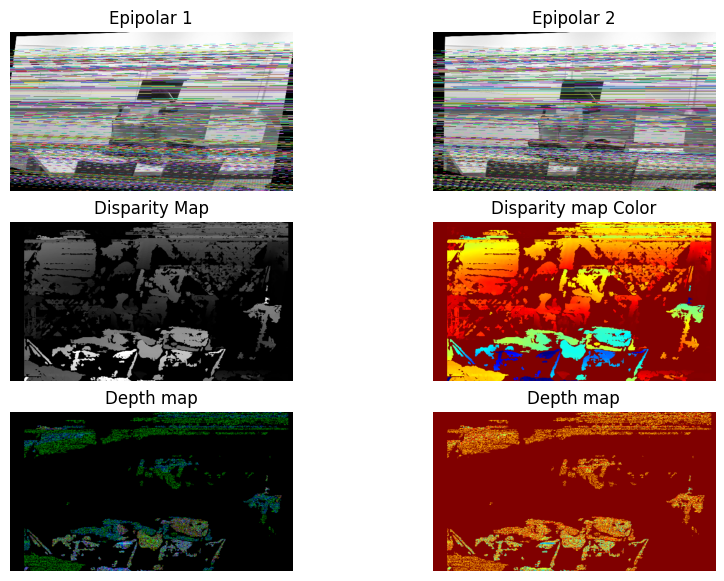

In [ ]:
# Implementing the pipeline for the dataset
pipeline(classroom_cam0_matrix,classroom_cam1_matrix,classroom_ndisp,classroom_focal_length,classroom_baseline,classroom_vmin,classroom_vmax,classroom_img_0,classroom_img_1,classroom_width,classroom_height)

The fundamental matrix is: [[-6.44454578e-09 -7.20814354e-05  5.18469023e-02]
 [ 7.20873675e-05 -2.76066087e-07 -2.60837841e-01]
 [-5.16746384e-02  2.58873851e-01  1.00000000e+00]]
The essential matrix is: [[-1.95588565e-02 -2.18763354e+02  2.23509239e+01]
 [ 2.18781358e+02 -8.37846011e-01 -3.53585844e+02]
 [-2.20633016e+01  3.49652089e+02 -6.75154548e-03]]
The rotation matrixces are : [[ 9.99986666e-01 -6.15537244e-04 -5.12720358e-03]
 [ 6.09530031e-04  9.99999126e-01 -1.17311552e-03]
 [ 5.12792120e-03  1.16997469e-03  9.99986168e-01]] 
 [[ 0.43768835  0.09135105  0.89447409]
 [ 0.09025183 -0.99426462  0.05738002]
 [ 0.89458567  0.05561336 -0.44342264]] 
 and the translation vector is: [[0.84647508]
 [0.0534974 ]
 [0.52973386]]
The Homography matrices are: [[-1.66019992e-01 -9.62372471e-03 -8.19950249e+01]
 [ 7.16650622e-02 -2.59832498e-01 -7.26983059e+01]
 [ 9.99067461e-05  6.34985472e-06 -3.66338647e-01]] and 
[[ 6.34183103e-01  4.27397240e-02  3.28104770e+02]
 [-2.71739764e-01  9.8

<ipython-input-35-620358326252>:13: RuntimeWarning: invalid value encountered in cast
  grayscale_depth = (depth * 255).astype(np.uint8)


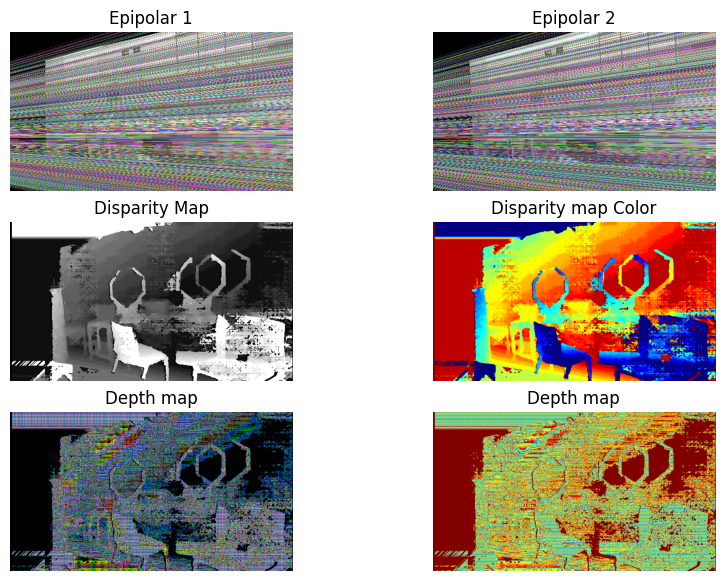

In [ ]:
# Implementing the pipeline for the dataset
pipeline(storageroom_cam0_matrix,storageroom_cam1_matrix,storageroom_ndisp,storageroom_focal_length,storageroom_baseline,storageroom_vmin,storageroom_vmax,storageroom_img_0,storageroom_img_1,storageroom_width,storageroom_height)


The fundamental matrix is: [[-1.81213354e-08 -2.07202327e-05  5.23661386e-03]
 [ 1.87154869e-05 -1.27528928e-07 -6.33446165e-01]
 [-4.19837879e-03  6.32397317e-01  1.00000000e+00]]
The essential matrix is: [[-5.67094826e-02 -6.48425544e+01 -1.01002543e+01]
 [ 5.85688392e+01 -3.99093077e-01 -1.07858804e+03]
 [ 9.98579259e+00  1.07198407e+03  3.58657173e-01]]
The rotation matrixces are : [[ 0.99326015 -0.01861196  0.11440223]
 [-0.01861713 -0.99982616 -0.00102335]
 [ 0.11440139 -0.00111339 -0.99343399]] 
 [[ 9.99981030e-01  8.22129153e-06 -6.15956065e-03]
 [-8.14808423e-06  1.00000000e+00  1.19102451e-05]
 [ 6.15956075e-03 -1.18598305e-05  9.99981030e-01]] 
 and the translation vector is: [[ 0.99813238]
 [-0.00932677]
 [ 0.06037191]]
The Homography matrices are: [[-5.92118157e-01  1.73228310e-02 -1.06753060e+01]
 [ 4.35205195e-03 -6.32502437e-01 -6.17801490e+00]
 [ 1.93219906e-05 -3.38729437e-07 -6.53927742e-01]] and 
[[ 9.67479000e-01 -9.36487473e-03  3.62771919e+01]
 [-8.58749836e-03  

<ipython-input-41-620358326252>:13: RuntimeWarning: invalid value encountered in cast
  grayscale_depth = (depth * 255).astype(np.uint8)


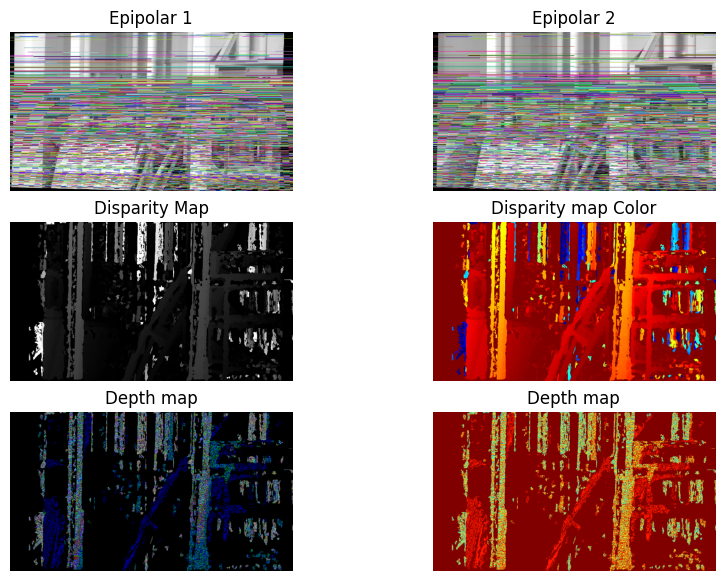

In [ ]:
# Implementing the pipeline for the dataset
pipeline(traproom_cam0_matrix,traproom_cam1_matrix,traproom_ndisp,traproom_focal_length,traproom_baseline,traproom_vmin,traproom_vmax,traproom_img_0,traproom_img_1,traproom_width,traproom_height)
